In [1]:
#掛載GoogleDrive
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# **人臉辨識**

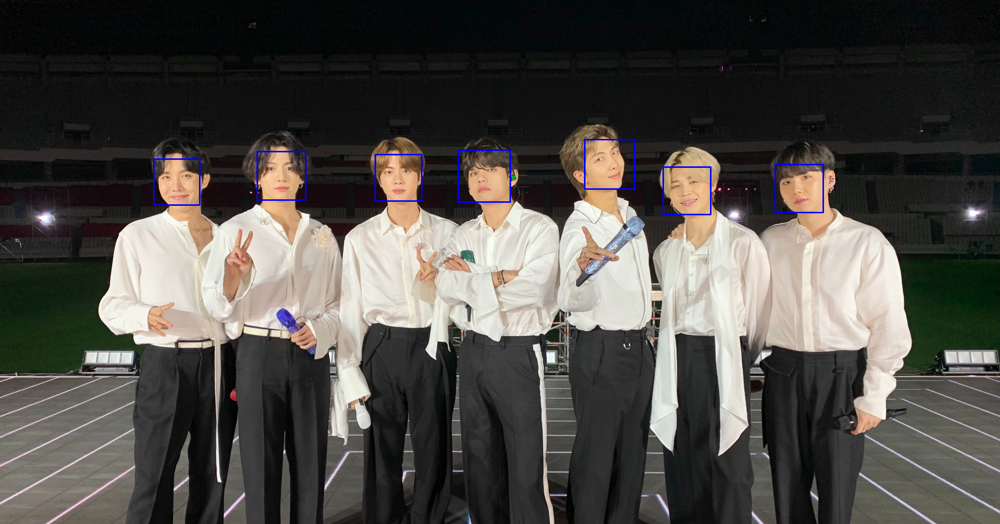

In [2]:
#載入相關套件
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

#載入人臉偵測訓練集
pathname = '/content/gdrive/My Drive/大數據/'
face_cascade = cv2.CascadeClassifier(pathname+'data/haarcascades/haarcascade_frontalface_alt.xml')
filename = 'ccc.png'
img0=cv2.imread(pathname + filename)
img = cv2.imread(pathname + filename)
image=cv2.imread(pathname + filename)
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) #影像轉灰階

faces = face_cascade.detectMultiScale(gray, 1.05, 3) #偵測人臉

#繪製人臉矩形框
for (x,y,w,h) in faces:
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2) #繪製人臉矩形框
    #cv2.rectangle(img,(x+10,y+15),(x+w-15,y+h),(255,0,0),2) #精確
    roi_gray = gray[y:y+h, x:x+w] #讀取人臉區域灰階影像
    roi_color = img[y:y+h, x:x+w] #讀取人臉區域彩色影像
cv2_imshow(img)

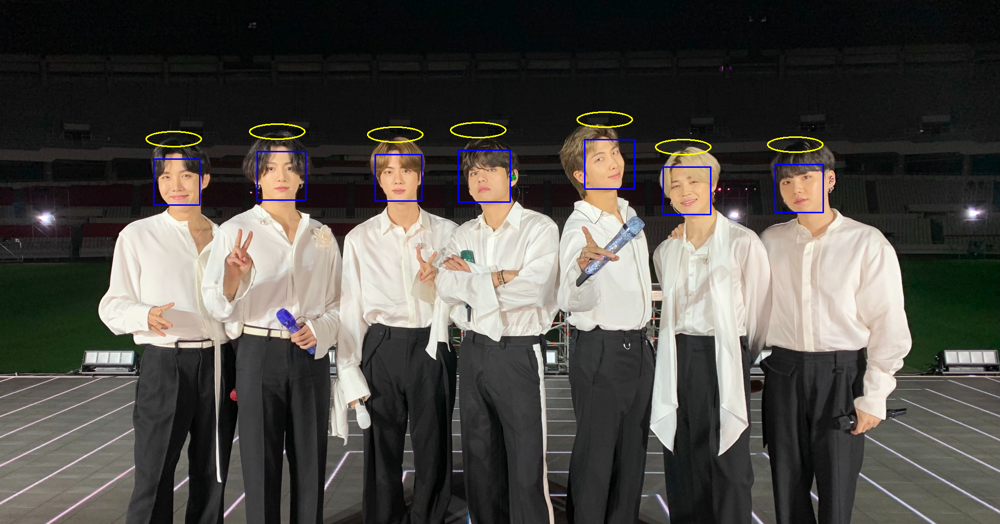

True

In [3]:
#於每個人頭頂繪製橢圓形光環(影像, 中心座標, 軸長, 旋轉角度, 起始角度, 結束角度, 顏色, 線條寬度)
for (x,y,w,h) in faces:
  cv2.ellipse(img, (x+40,y-40),(15, 55), 90, 0, 360, (0, 255, 255), 2)
#顯示圖片
cv2_imshow(img)
#儲存圖片
cv2.imwrite('ring.jpg', img)

# **膚色遮罩**

In [4]:
#將矩形框(ROI)影像，轉換至 HSV 色空間，用 cv2.meanStdDev 統計 Hue, Saturation, Value 這三個色彩通道的平均值(mean)與標準差(StdDev)
hsv1 = cv2.cvtColor(img[y+15:y+h, x+10:x+w-15],cv2.COLOR_BGR2HSV) #(x+10,y+15),(x+w-15,y+h)
(mean , stdev) = cv2.meanStdDev(hsv1)
print(mean)
print(stdev)
#img = cv2.resize(img, (0,0), fx=0.5, fy=0.5)

[[ 22.27848101]
 [103.087612  ]
 [167.95249609]]
[[36.37411046]
 [27.17694887]
 [72.85411328]]


In [5]:
#將原圖影像，轉換至 HSV 色空間
hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

img


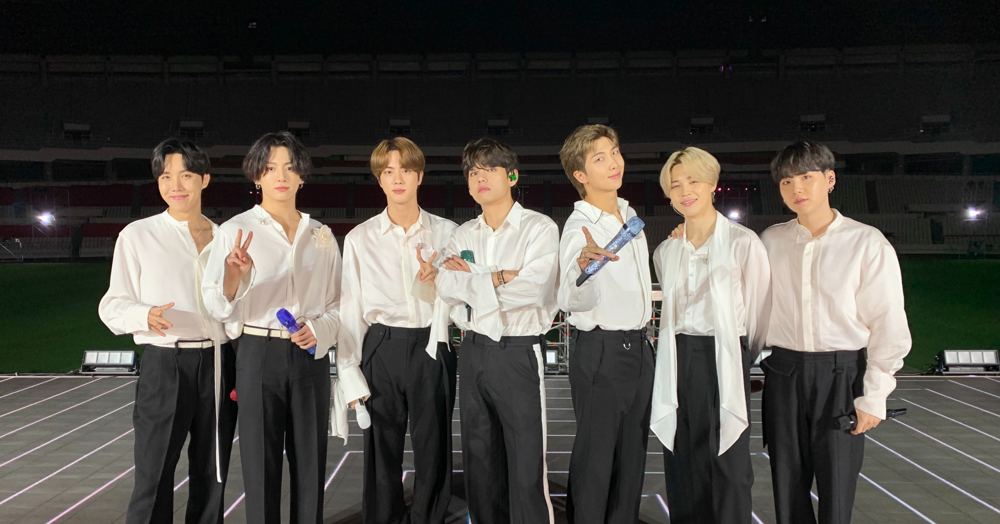

mask


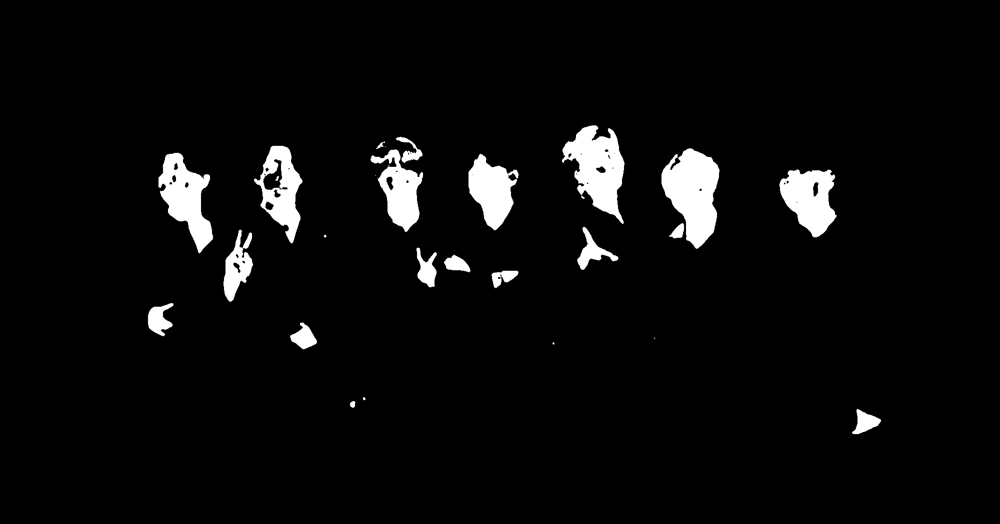

result


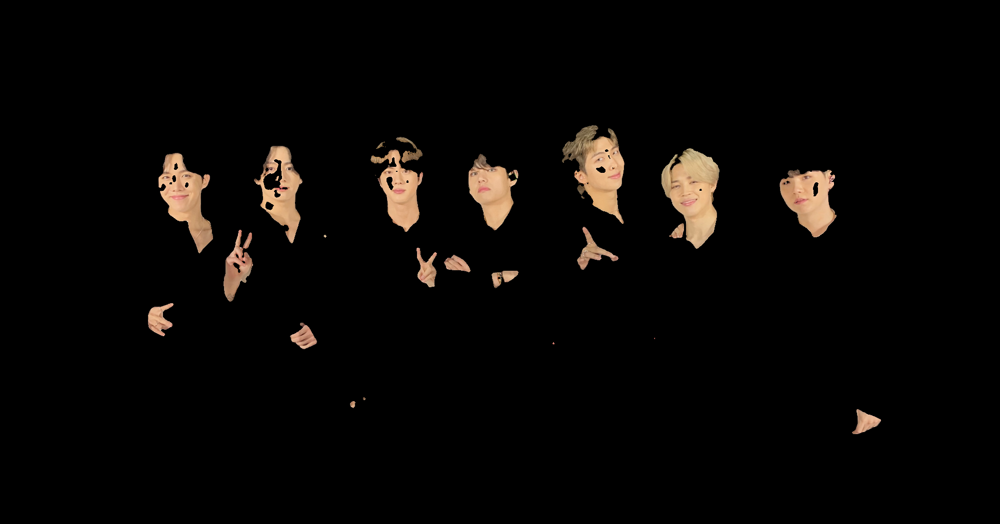

True

In [6]:
# 定義 HSV (hue, saturation, value) 空間的色彩範圍 
lower_range = mean-stdev
upper_range = mean+stdev # maximum [180, 256, 256]
# 取得色彩範圍內影像區域遮罩
mask = cv2.inRange(hsv, lower_range, upper_range)
# 中值濾波 (除脈衝雜訊)
mask = cv2.medianBlur(mask, 7)
# 根據遮罩複製影像
res= cv2.bitwise_and(image, image, mask= mask)
print('img'), cv2_imshow(image)
print('mask'), cv2_imshow(mask)
print('result'), cv2_imshow(res)
#儲存圖片
cv2.imwrite('mask.jpg', mask)

# **影像腐蝕與膨脹**

In [7]:
#影像腐蝕與膨脹
def showImages(img1,img2,img3):
  #plt.subplot(131),plt.imshow(img1),plt.title('Source'),plt.xticks([]),plt.yticks([])
  #plt.subplot(132),plt.imshow(img2),plt.title('Erosion'),plt.xticks([]),plt.yticks([])
  #plt.subplot(133),plt.imshow(img3),plt.title('Dilation'),plt.xticks([]),plt.yticks([])
  height,width,channel = img1.shape
  images = np.hstack((img1, img2, img3))
  cv2.putText(images,'Source',(10,40),cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,255),2) #放置文字
  cv2.putText(images,'Erosion',(10+width,40),cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,255),2)
  cv2.putText(images,'Dilation',(10+2*width,40),cv2.FONT_HERSHEY_SIMPLEX, 1,(0,255,255),2)
  cv2_imshow(images)

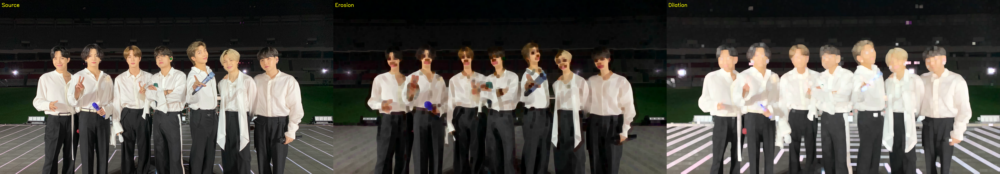

In [8]:
s = 15 #@param {type:"slider", min:1, max:15, step:1}
#建立一個 sxs 的結構元素（核心）

kernel = np.ones((s,s), np.uint8)
#侵蝕_語法：erode(輸入圖, 結構元素, 執行次數)
#消融物體的邊界；如果物體比結構元素小，則物體會消失；可用來消除雜訊
erosion = cv2.erode(image, kernel)
#膨脹_語法：dilate(輸入圖, 結構元素, 執行次數)
#擴大物體的邊界；如果兩物體間有小於結構元素的間隙，則兩物體會連接起來；可用來填補間隙
dilation = cv2.dilate(image, kernel)

showImages(image,erosion,dilation)

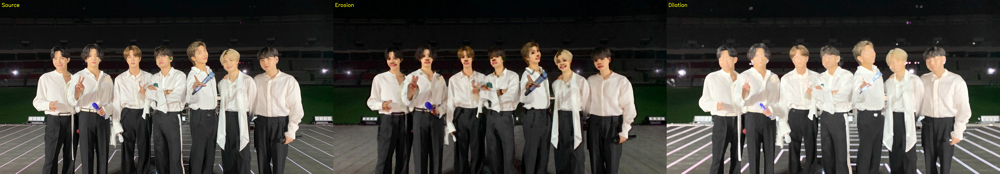

In [9]:
s = 10 #@param {type:"slider", min:1, max:15, step:1}
op = "ELLIPSE" #@param ["RECT", "CROSS", "ELLIPSE"]

if op=='RECT':
  shape=cv2.MORPH_RECT
elif op=='CROSS':
  shape=cv2.MORPH_CROSS
elif op=='ELLIPSE':
  shape=cv2.MORPH_ELLIPSE

#建立一個 sxs 的結構元素（核心）
kernel	=	cv2.getStructuringElement(shape	, (s,s))

#侵蝕_語法：erode(輸入圖, 結構元素, 執行次數)
#消融物體的邊界；如果物體比結構元素小，則物體會消失；可用來消除雜訊
erosion = cv2.erode(image, kernel)
#膨脹_語法：dilate(輸入圖, 結構元素, 執行次數)
#擴大物體的邊界；如果兩物體間有小於結構元素的間隙，則兩物體會連接起來；可用來填補間隙
dilation = cv2.dilate(image, kernel)

showImages(image,erosion,dilation)

# **自由發揮（卡通化）**

In [10]:
#自由發揮（卡通化）
num_down = 2 # 縮減畫素取樣的數目
num_bilateral = 7 # 定義雙邊濾波的數目
img_rgb = res
img_rgb=cv2.resize(img_rgb,(2000,1050))
# 用高斯金字塔降低取樣
img_color = img_rgb
for _ in range(num_down):
  img_color = cv2.pyrDown(img_color)
# 重複使用小的雙邊濾波代替一個大的濾波
for _ in range(num_bilateral):
  img_color = cv2.bilateralFilter(img_color,d=9,sigmaColor=9,sigmaSpace=7)
# 升取樣圖片到原始大小
for _ in range(num_down ):
  img_color = cv2.pyrUp(img_color)

In [11]:
# 轉換為灰度並使其產生中等的模糊
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
img_blur = cv2.medianBlur(img_gray, 7)

In [12]:
# 檢測到邊緣並且增強其效果
img_edge = cv2.adaptiveThreshold(img_blur, 255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,blockSize=9,C=2)
img_edge=cv2.resize(img_edge,(2000,1050))
img_color=cv2.resize(img_color,(2000,1050))
#img_color.shape
img_color = cv2.resize(img_color, (2000, 1050))

In [14]:
# 轉換回彩色影象
img_edge = cv2.cvtColor(img_edge, cv2.COLOR_GRAY2RGB)
img_cartoon = cv2.bitwise_and(img_color, img_edge)

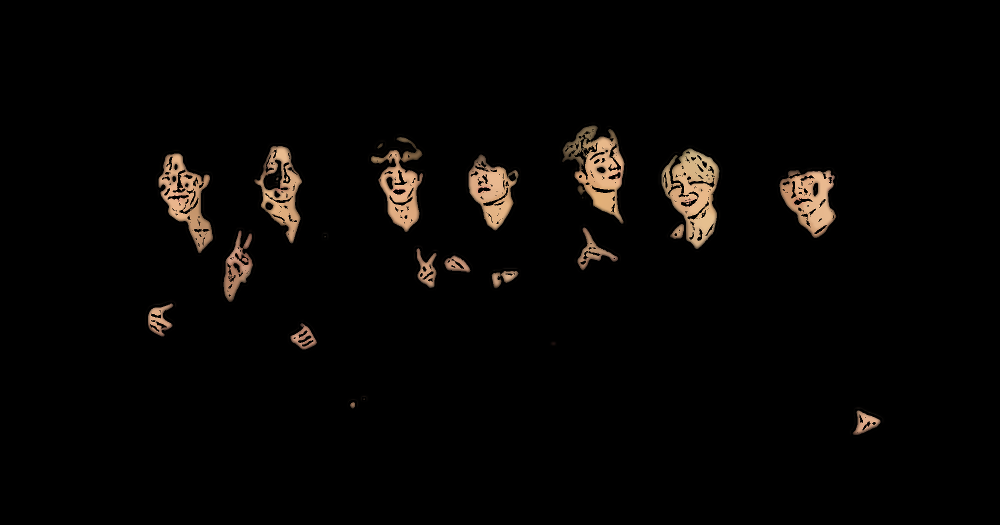

In [15]:
# 顯示圖片
cv2_imshow(img_cartoon)

In [16]:
#儲存圖片
cv2.imwrite('img_cartoon.jpg', img_cartoon)

True

In [17]:
#查看圖片大小
img0.shape

(1049, 2000, 3)

In [18]:
#查看圖片大小
img_cartoon.shape

(1050, 2000, 3)

In [19]:
#改變圖片大小
img0 = cv2.resize(img0, (2000, 1050))

In [20]:
#查看圖片大小
img0.shape

(1050, 2000, 3)

In [21]:
#結合圖片（圖片1,圖片1的融合比例,圖片2,圖片2的融合比例,偏差值)
merge=cv2.addWeighted(img0,0.45,img_cartoon,0.55,0)

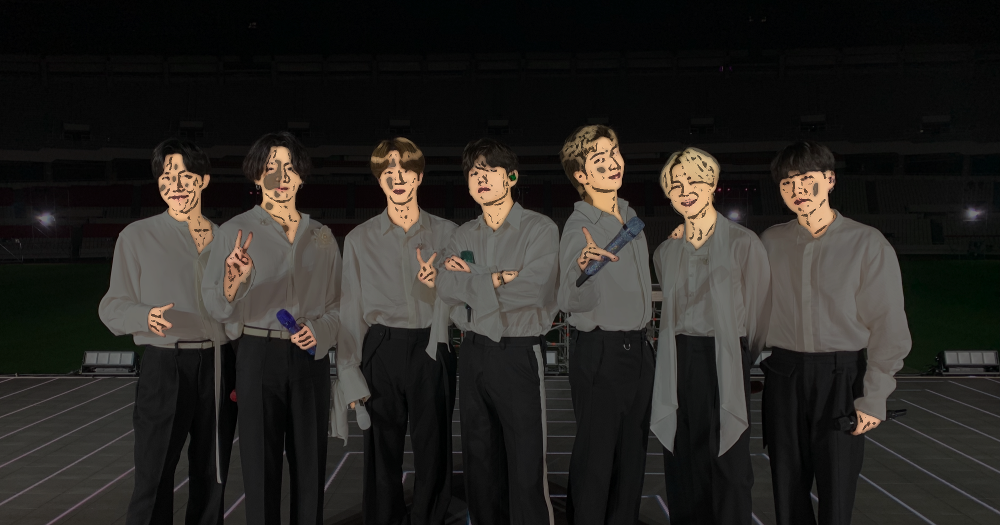

In [22]:
cv2_imshow(merge)

In [23]:
#插入文字（照片/繪製的文字/左上角坐標/字體/字體大小/顏色/字體粗細）
text = 'B10833022'
cv2.putText(merge, text, (900, 900), cv2.FONT_HERSHEY_SIMPLEX,
  1, (0, 255, 255), 1, cv2.LINE_AA)

array([[[ 5,  5,  5],
        [ 6,  6,  6],
        [ 6,  6,  6],
        ...,
        [ 3,  3,  3],
        [ 5,  3,  4],
        [ 5,  3,  3]],

       [[ 4,  4,  4],
        [ 5,  5,  5],
        [ 6,  6,  6],
        ...,
        [ 4,  3,  3],
        [ 5,  4,  4],
        [ 6,  5,  5]],

       [[ 5,  5,  5],
        [ 4,  4,  4],
        [ 4,  4,  4],
        ...,
        [ 3,  3,  3],
        [ 4,  4,  4],
        [ 4,  4,  4]],

       ...,

       [[46, 50, 54],
        [46, 50, 54],
        [46, 50, 54],
        ...,
        [38, 44, 45],
        [40, 45, 46],
        [41, 45, 46]],

       [[48, 52, 56],
        [45, 50, 53],
        [46, 50, 54],
        ...,
        [37, 43, 44],
        [40, 45, 46],
        [41, 45, 46]],

       [[44, 48, 52],
        [45, 50, 53],
        [45, 49, 52],
        ...,
        [39, 45, 46],
        [40, 45, 46],
        [41, 45, 46]]], dtype=uint8)

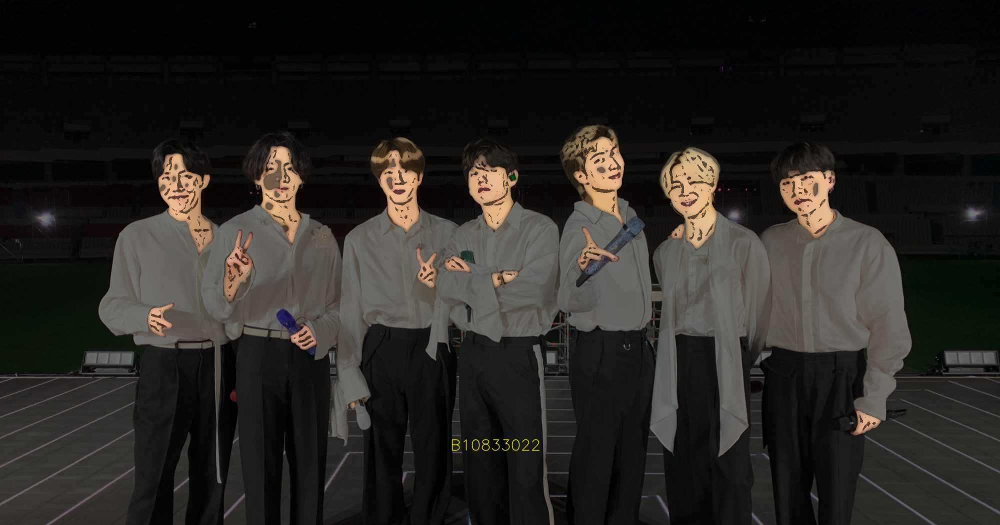

In [24]:
#顯示圖片
cv2_imshow(merge)

In [25]:
#儲存圖片
cv2.imwrite('play freely.jpg', merge)

True